# Create GeoJSON of Taipei City

In [ ]:
from urllib.request import urlopen
import folium
from folium import IFrame
import json
from geopy.geocoders import Nominatim 
from pandas.io.json import json_normalize
from geopy.geocoders import Nominatim 

In [ ]:
# Load Taipei GeoJSON file
with urlopen('https://raw.githubusercontent.com/littlebtc/geodata4appy/master/simplified/taipei.geojson') as response:
    tp = json.load(response)

# Check on map 
address = 'Taipei'

geolocator = Nominatim(user_agent="tp_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude

tp_map = folium.Map(location=[latitude, longitude], tiles='cartodbpositron', zoom_start=12)

folium.GeoJson(
    tp,
    name='geojson'
).add_to(tp_map)

# Check in dataframe
df_tp = json_normalize(tp['features'])

# Rename column names for later use
df_tp.rename(columns={'properties.TVNAME':'dist_neigh', 
                      'properties.PNAME':'city',
                      'properties.TNAME':'dist',
                      'properties.VNAME':'neigh'
                      }, 
             inplace=True)

# df_tp = df_tp[['dist_neigh','geometry.coordinates']]

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:21: FutureWarning: pandas.io.json.json_normalize is deprecated, use pandas.json_normalize instead


In [ ]:
tp_map

In [ ]:
# from google.colab import files
# map.save('tp_map.html')
# files.download('tp_map.html')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# FIND NEIGHBORING NEIGHBORHOODS

In [ ]:
import pandas as pd

In [ ]:
# Remove duplicated coordinates in polygons of neighborhoods
df_tp['new_coordinates'] = None
new_coordinates = []
for i in range(len(df_tp)):
  coord = df_tp.loc[i,'geometry.coordinates'][0]
  new_coord = []
  for elem in coord:
    if elem not in new_coord:
      new_coord.append(elem)
  new_coordinates.append([new_coord])

df_tp['new_coordinates'] = pd.DataFrame(new_coordinates)

In [ ]:
# Find neighbors by looking for whether there are same coordinates between twwo polygons 
neighborhoods = []
for i in range(len(df_tp)):
  nei = []
  for j in range(len(df_tp)):
    match = 0
    for x in df_tp.loc[i,'new_coordinates']:
      for y in df_tp.loc[j,'new_coordinates']:  
        if y == x:
          match += 1
    # nei.append(match)
    if match >= 2 and j != i: # neighboring polygons must have share more than 1 coordinates to form a line
      nei.append(j)
  neighborhoods.append([nei])

df_tp['neighborhoods'] = None
df_tp['neighborhoods'] = pd.DataFrame(neighborhoods)
df_neighborhoods = df_tp[['dist_neigh','neighborhoods']]

df_neighborhoods

,dist_neigh,neighborhoods
0,松山區莊敬里,"[3, 4, 5, 8, 141, 143, 167, 327, 352]"
1,松山區東榮里,"[2, 7, 8]"
2,松山區三民里,"[1, 4, 6, 7, 8, 19]"
3,松山區新益里,"[0, 4, 5]"
4,松山區富錦里,"[0, 2, 3, 5, 6, 8]"
...,...,...
451,北投區關渡里,"[386, 431, 450]"
452,北投區泉源里,"[422, 439, 440, 442, 453, 454, 455]"
453,北投區湖山里,"[404, 408, 409, 422, 452, 455]"
454,北投區大屯里,"[442, 443, 445, 452, 455]"


# Social Network Analysis

## Network Representation

### Plain network

In [ ]:
import networkx as nx
import matplotlib.pyplot as plt

def draw_basic_network_graph(graph):
    G = nx.Graph()
    G.add_edges_from(graph)
    plt.figure(figsize=(10,10)) 
    nx.draw(G, with_labels=True, node_size=200, font_size=7, font_color="yellow", font_weight="bold")
    plt.show()

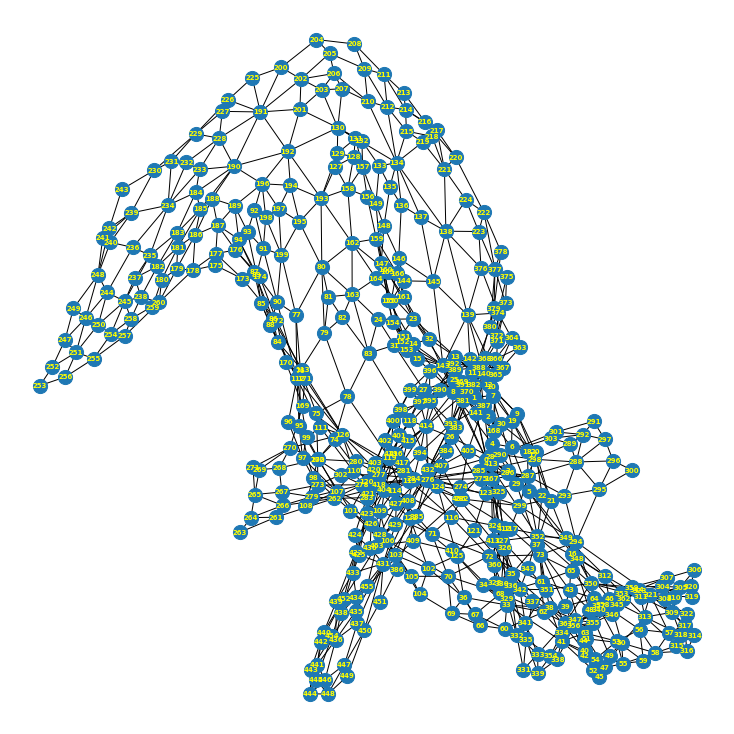

In [ ]:
edges = []
for j in range(len(df_neighborhoods)):
  for i in range(len(df_neighborhoods.loc[j,'neighborhoods'])):
    des = df_neighborhoods.loc[j,'neighborhoods'][i]
    edges.append((j,des))
    
draw_basic_network_graph(edges)

### Show the vertex (neighborhoods) and edges (connections) on map

In [ ]:
# Functions to find the centroid of a polygon in GeoJSON file
# Credited to brandonxiang/geojson-python-utils: https://github.com/brandonxiang/geojson-python-utils/blob/develop/README_CN.md

def centroid(poly):
    """
    get the centroid of polygon
    adapted from http://paulbourke.net/geometry/polyarea/javascript.txt
    Keyword arguments:
    poly -- polygon geojson object
    return polygon centroid
    """
    f_total = 0
    x_total = 0
    y_total = 0
    # TODO: polygon holes at coordinates[1]
    points = poly['coordinates'][0]
    j = len(points) - 1
    count = len(points)

    for i in range(0, count):
        p1_x = points[i][1]
        p1_y = points[i][0]
        p2_x = points[j][1]
        p2_y = points[j][0]

        f_total = p1_x * p2_y - p2_x * p1_y
        x_total += (p1_x + p2_x) * f_total
        y_total += (p1_y + p2_y) * f_total
        j = i

    six_area = area(poly) * 6
    return {'type': 'Point', 'coordinates': [y_total / six_area, x_total / six_area]}

def area(poly):
    """
    calculate the area of polygon
    Keyword arguments:
    poly -- polygon geojson object
    return polygon area
    """
    poly_area = 0
    # TODO: polygon holes at coordinates[1]
    points = poly['coordinates'][0]
    j = len(points) - 1
    count = len(points)

    for i in range(0, count):
        p1_x = points[i][1]
        p1_y = points[i][0]
        p2_x = points[j][1]
        p2_y = points[j][0]

        poly_area += p1_x * p2_y
        poly_area -= p1_y * p2_x
        j = i

    poly_area /= 2
    return poly_area

def add_centroid():
  paragraph = """<p>{}</p>""".format

  for lat, lng, dist_neigh in zip(df_tp['centroid_lat'], df_tp['centroid_lng'], df_tp['dist_neigh']):
    label = '{}'.format(dist_neigh)
    iframe = IFrame(html = paragraph(utf2asc(label)),
                width=100,
                height=50)
    popup = folium.Popup(iframe)
    folium.CircleMarker(
        [lat, lng],
        radius = 3,
        popup = popup,
        color = 'grey',
        fill = True,
        fill_color = '#3186cc',
        fill_opacity = 0.7,
        parse_html = False).add_to(map)  

  return map

def utf2asc(s): 
    return str(str(s).encode('ascii', 'xmlcharrefreplace'))[2:-1]

In [ ]:
# Find centroid of every neighborhood and add the laitudes and longitudes to new columns 
tp_lon = []
tp_lat = []
for i in range(456):
  box = tp['features'][i]['geometry']
  center = centroid(box)
  tp_lon.append(center['coordinates'][0])
  tp_lat.append(center['coordinates'][1])

df_tp['centroid_lat'] = tp_lat
df_tp['centroid_lng'] = tp_lon
df_neighborhoods = df_tp[['dist_neigh','neighborhoods', 'centroid_lat', 'centroid_lng']]
df_neighborhoods

,dist_neigh,neighborhoods,centroid_lat,centroid_lng
0,松山區莊敬里,"[3, 4, 5, 8, 141, 143, 167, 327, 352]",25.070698,121.563780
1,松山區東榮里,"[2, 7, 8]",25.060350,121.558050
2,松山區三民里,"[1, 4, 6, 7, 8, 19]",25.060024,121.562244
3,松山區新益里,"[0, 4, 5]",25.061795,121.567122
4,松山區富錦里,"[0, 2, 3, 5, 6, 8]",25.060958,121.564352
...,...,...,...,...
451,北投區關渡里,"[386, 431, 450]",25.117710,121.467772
452,北投區泉源里,"[422, 439, 440, 442, 453, 454, 455]",25.153236,121.520774
453,北投區湖山里,"[404, 408, 409, 422, 452, 455]",25.149328,121.539538
454,北投區大屯里,"[442, 443, 445, 452, 455]",25.160564,121.505817


In [ ]:
edges = []
for j in range(len(df_neighborhoods)):
  for i in range(len(df_neighborhoods.loc[j,'neighborhoods'])):
    edge = []
    des = df_neighborhoods.loc[j,'neighborhoods'][i]
    edge.append([df_neighborhoods.loc[j,'centroid_lat'], df_neighborhoods.loc[j,'centroid_lng']])
    edge.append([df_neighborhoods.loc[des,'centroid_lat'], df_neighborhoods.loc[des,'centroid_lng']])
    edges.append(edge)

In [ ]:
map = folium.Map(location=[latitude, longitude], tiles='cartodbpositron', zoom_start=12)

folium.PolyLine(edges,
  color='blue',
  weight=0.5,
  opacity=0.5).add_to(map)

add_centroid()

map

In [ ]:
# from google.colab import files
# map.save('plain_networks.html')
# files.download('plain_networks.html')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## Network Measurements:Centralities

In [ ]:
df_neighborhoods

In [ ]:
G_edges = []
for j in range(len(df_neighborhoods)):
  for i in range(len(df_neighborhoods.loc[j,'neighborhoods'])):
    des = df_neighborhoods.loc[j,'neighborhoods'][i]
    G_edges.append([j, des])

In [ ]:
G = nx.Graph()
G.add_edges_from(G_edges)

### Centrality Calculation

In [ ]:
c_degree_dict = nx.degree_centrality(G)
c_closeness_dict = nx.closeness_centrality(G)
c_betweenness_dict = nx.betweenness_centrality(G)

c_degree_list = []
c_closeness_list = []
c_betweenness_list = []
for i in range(456):
  c_degree_list.append(c_degree_dict[i])
  c_closeness_list.append(c_closeness_dict[i])
  c_betweenness_list.append(c_betweenness_dict[i])

df_tp['c_degree'] = pd.Series(c_degree_list)
df_tp['c_closeness'] = pd.Series(c_closeness_list)
df_tp['c_betweenness'] = pd.Series(c_betweenness_list)
df_tp_c = df_tp[['dist_neigh', 'centroid_lat', 'centroid_lng', 'c_degree', 'c_closeness', 'c_betweenness']]
df_tp_c

,dist_neigh,centroid_lat,centroid_lng,c_degree,c_closeness,c_betweenness
0,松山區莊敬里,25.070698,121.563780,0.019780,0.154028,0.178926
1,松山區東榮里,25.060350,121.558050,0.006593,0.132499,0.000548
2,松山區三民里,25.060024,121.562244,0.013187,0.134655,0.003476
3,松山區新益里,25.061795,121.567122,0.006593,0.135861,0.000000
4,松山區富錦里,25.060958,121.564352,0.013187,0.140086,0.004779
...,...,...,...,...,...,...
451,北投區關渡里,25.117710,121.467772,0.006593,0.091771,0.000025
452,北投區泉源里,25.153236,121.520774,0.015385,0.096809,0.014266
453,北投區湖山里,25.149328,121.539538,0.013187,0.105324,0.019233
454,北投區大屯里,25.160564,121.505817,0.010989,0.095669,0.016997


In [ ]:
# Degree Centrality Ranking
c_degree_df_top = df_tp_c.sort_values(by=['c_degree'], ascending=False).head(10)[['dist_neigh', 'c_degree']]
c_degree_df_top.reset_index(drop=True, inplace=True)
c_degree_df_top.rename(columns = {'dist_neigh': 'Top10'}, inplace=True)

c_degree_df_bot = df_tp_c.sort_values(by=['c_degree'], ascending=True).head(10)[['dist_neigh', 'c_degree']]
c_degree_df_bot.reset_index(drop=True, inplace=True)
c_degree_df_bot.rename(columns = {'dist_neigh': 'Bottom10'}, inplace=True)

c_degree_ranking = pd.concat([c_degree_df_top, c_degree_df_bot], axis=1)
c_degree_ranking

,Top10,c_degree,Bottom10,c_degree
0,北投區八仙里,0.026374,萬華區榮德里,0.004396
1,大安區學府里,0.026374,萬華區柳鄉里,0.004396
2,士林區福林里,0.024176,文山區景美里,0.004396
3,中山區集英里,0.021978,文山區試院里,0.004396
4,南港區九如里,0.021978,文山區政大里,0.004396
5,松山區精忠里,0.021978,士林區平等里,0.004396
6,中山區大佳里,0.021978,大安區群英里,0.004396
7,松山區莊敬里,0.019780,南港區舊莊里,0.004396
8,內湖區港墘里,0.019780,信義區正和里,0.006593
9,北投區建民里,0.019780,士林區仁勇里,0.006593


In [ ]:
# Closeness Centrality Ranking
c_closeness_df_top = df_tp_c.sort_values(by=['c_closeness'], ascending=False).head(10)[['dist_neigh', 'c_closeness']]
c_closeness_df_top.reset_index(drop=True, inplace=True)
c_closeness_df_top.rename(columns = {'dist_neigh': 'Top10'}, inplace=True)

c_closeness_df_bot = df_tp_c.sort_values(by=['c_closeness'], ascending=True).head(10)[['dist_neigh', 'c_closeness']]
c_closeness_df_bot.reset_index(drop=True, inplace=True)
c_closeness_df_bot.rename(columns = {'dist_neigh': 'Bottom10'}, inplace=True)

c_closeness_ranking = pd.concat([c_closeness_df_top, c_closeness_df_bot], axis=1)
c_closeness_ranking

,Top10,c_closeness,Bottom10,c_closeness
0,中山區劍潭里,0.157005,萬華區榮德里,0.071789
1,中山區大佳里,0.156411,萬華區銘德里,0.075331
2,松山區莊敬里,0.154028,萬華區華中里,0.077276
3,中山區新庄里,0.152072,萬華區錦德里,0.077938
4,松山區精忠里,0.151717,萬華區孝德里,0.079351
5,中山區圓山里,0.151414,北投區文化里,0.080545
6,松山區中華里,0.148790,萬華區保德里,0.081395
7,中山區集英里,0.147871,北投區智仁里,0.081776
8,中山區成功里,0.146727,文山區景美里,0.082487
9,松山區中正里,0.146491,北投區稻香里,0.082517


In [ ]:
# Betweenness Centrality Ranking
c_betweenness_df_top = df_tp_c.sort_values(by=['c_betweenness'], ascending=False).head(10)[['dist_neigh', 'c_betweenness']]
c_betweenness_df_top.reset_index(drop=True, inplace=True)
c_betweenness_df_top.rename(columns = {'dist_neigh': 'Top10'}, inplace=True)

c_betweenness_df_bot = df_tp_c.sort_values(by=['c_betweenness'], ascending=True).head(10)[['dist_neigh', 'c_betweenness']]
c_betweenness_df_bot.reset_index(drop=True, inplace=True)
c_betweenness_df_bot.rename(columns = {'dist_neigh': 'Bottom10'}, inplace=True)

c_betweenness_ranking = pd.concat([c_betweenness_df_top, c_betweenness_df_bot], axis=1)
c_betweenness_ranking

,Top10,c_betweenness,Bottom10,c_betweenness
0,中山區集英里,0.225073,士林區仁勇里,0.000000
1,中山區劍潭里,0.209064,文山區景美里,0.000000
2,中山區圓山里,0.200971,大安區群英里,0.000000
3,中正區黎明里,0.200193,文山區明興里,0.000000
4,中山區民安里,0.198732,文山區政大里,0.000000
5,士林區福林里,0.181170,松山區新益里,0.000000
6,松山區莊敬里,0.178926,南港區舊莊里,0.000000
7,中山區大佳里,0.159007,文山區試院里,0.000000
8,大安區學府里,0.150363,萬華區榮德里,0.000005
9,中正區建國里,0.129745,北投區文林里,0.000005


### Nodes & Edges View

In [ ]:
# Normalize the numbers for drawing use only
# normalize degree centralities 
max_value = df_tp_c['c_degree'].max()
min_value = df_tp_c['c_degree'].min()
df_tp_c['c_degree_norm'] = 1 + (df_tp_c['c_degree'] - min_value) / (max_value - min_value) * 9

# normalize closeness centralities 
max_value = df_tp_c['c_closeness'].max()
min_value = df_tp_c['c_closeness'].min()
df_tp_c['c_closeness_norm'] = 1 + (df_tp_c['c_closeness'] - min_value) / (max_value - min_value) * 9

# normalize betweenness centralities 
max_value = df_tp_c['c_betweenness'].max()
min_value = df_tp_c['c_betweenness'].min()
df_tp_c['c_betweenness_norm'] = 1 + (df_tp_c['c_betweenness'] - min_value) / (max_value - min_value) * 9

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if __name__ == '__main__':
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cavea

In [ ]:
# Degree Centrality 
map = folium.Map(location=[latitude, longitude], tiles='cartodbpositron', zoom_start=12)

# add edges
folium.PolyLine(edges,
  color='blue',
  weight=0.5,
  opacity=0.4).add_to(map)

# add nodes weighted by degree centrality 
paragraph = """<p>{}</p>""".format

for lat, lng, dist_neigh, radius in zip(df_tp_c['centroid_lat'], df_tp_c['centroid_lng'], df_tp_c['dist_neigh'], df_tp_c['c_degree_norm']):
  label = '{}'.format(dist_neigh)
  iframe = IFrame(html = paragraph(utf2asc(label)),
              width=100,
              height=50)
  popup = folium.Popup(iframe)
  folium.CircleMarker(
      [lat, lng],
      radius = radius,
      popup = popup,
      color = '#3186cc',
      fill = True,
      fill_color = 'grey',
      fill_opacity = 0.5,
      parse_html = False).add_to(map)  

In [ ]:
map

In [ ]:
# map.save('plain_degree_centrality.html')
# files.download('plain_degree_centrality.html')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# Closeness Centrality 
map = folium.Map(location=[latitude, longitude], tiles='cartodbpositron', zoom_start=12)

# add edges
folium.PolyLine(edges,
  color='brown',
  weight=0.5,
  opacity=0.5).add_to(map)

# add nodes weighted by closeness centrality 
paragraph = """<p>{}</p>""".format

for lat, lng, dist_neigh, radius in zip(df_tp_c['centroid_lat'], df_tp_c['centroid_lng'], df_tp_c['dist_neigh'], df_tp_c['c_closeness_norm']):
  label = '{}'.format(dist_neigh)
  iframe = IFrame(html = paragraph(utf2asc(label)),
              width=100,
              height=50)
  popup = folium.Popup(iframe)
  folium.CircleMarker(
      [lat, lng],
      radius = radius,
      popup = popup,
      color = 'brown',
      fill = True,
      fill_color = 'grey',
      fill_opacity = 0.5,
      parse_html = False).add_to(map)  

In [ ]:
map

In [ ]:
# map.save('plain_closeness_centrality.html')
# files.download('plain_closeness_centrality.html')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# Between Centrality
map = folium.Map(location=[latitude, longitude], tiles='cartodbpositron', zoom_start=12)

# add edges
folium.PolyLine(edges,
  color='green',
  weight=0.5,
  opacity=0.4).add_to(map)

# add nodes weighted by between centrality 
paragraph = """<p>{}</p>""".format

for lat, lng, dist_neigh, radius in zip(df_tp_c['centroid_lat'], df_tp_c['centroid_lng'], df_tp_c['dist_neigh'], df_tp_c['c_betweenness_norm']):
  label = '{}'.format(dist_neigh)
  iframe = IFrame(html = paragraph(utf2asc(label)),
              width=100,
              height=50)
  popup = folium.Popup(iframe)
  folium.CircleMarker(
      [lat, lng],
      radius = radius,
      popup = popup,
      color = 'green',
      fill = True,
      fill_color = 'grey',
      fill_opacity = 0.5,
      parse_html = False).add_to(map)  

In [ ]:
map

In [ ]:
# map.save('plain_betweenness_centrality.html')
# files.download('plain_betweenness_centrality.html')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### Zonal View

In [ ]:
# Degree Centrality
map = folium.Map(location=[latitude, longitude], tiles='cartodbpositron', zoom_start=12)

folium.Choropleth(
    geo_data = tp,
    name = 'Degree Centrality',
    data = df_tp_c,
    columns = ['dist_neigh', 'c_degree'],
    key_on = 'properties.TVNAME',
    fill_color = 'PuBu',
    fill_opacity = 0.7,
    line_opacity = 0.2,
    legend_name='Degree Centrality').add_to(map)

map

In [ ]:
# Closeness Centrality
map = folium.Map(location=[latitude, longitude], tiles='cartodbpositron', zoom_start=12)

folium.Choropleth(
    geo_data = tp,
    name = 'Closeness Centrality',
    data = df_tp_c,
    columns = ['dist_neigh', 'c_closeness'],
    key_on = 'properties.TVNAME',
    fill_color = 'YlOrBr',
    fill_opacity = 0.7,
    line_opacity = 0.2,
    legend_name = 'Closeness Centrality').add_to(map)

map

In [ ]:
# Betweenness Centrality
map = folium.Map(location=[latitude, longitude], tiles='cartodbpositron', zoom_start=12)

folium.Choropleth(
    geo_data = tp,
    name = 'Betweenness Centrality',
    data = df_tp_c,
    columns = ['dist_neigh', 'c_betweenness'],
    key_on = 'properties.TVNAME',
    fill_color = 'RdPu',
    fill_opacity = 0.7,
    line_opacity = 0.2,
    legend_name = 'Betweenness Centrality').add_to(map)

map

## Network Measurements:Edge Betweenness Centrality

In [ ]:
edge_betweenness_dict = nx.edge_betweenness_centrality(G)

In [ ]:
edge_betweenness_df = pd.DataFrame.from_dict(edge_betweenness_dict, orient='index')
edge_betweenness_df.reset_index(inplace=True)
edge_betweenness_df.rename(columns = {'index': 'edge', 0: 'edge_betweenness'}, inplace=True)

ori = []
des = []
for i in edge_betweenness_df['edge']: 
  ori.append(df_neighborhoods['dist_neigh'][i[0]])
  des.append(df_neighborhoods['dist_neigh'][i[1]])

edge_betweenness_df['origin'] = pd.Series(ori)
edge_betweenness_df['destination'] = pd.Series(des)

edge_betweenness_df

,edge,edge_betweenness,origin,destination
0,"(0, 3)",0.002756,松山區莊敬里,松山區新益里
1,"(0, 4)",0.002600,松山區莊敬里,松山區富錦里
2,"(0, 5)",0.062630,松山區莊敬里,松山區新東里
3,"(0, 8)",0.036223,松山區莊敬里,松山區精忠里
4,"(0, 141)",0.029047,松山區莊敬里,中山區成功里
...,...,...,...,...
1182,"(444, 445)",0.001956,北投區智仁里,北投區秀山里
1183,"(444, 448)",0.000218,北投區智仁里,北投區稻香里
1184,"(454, 445)",0.008983,北投區大屯里,北投區秀山里
1185,"(445, 448)",0.003496,北投區秀山里,北投區稻香里


In [ ]:
# Edge Betweenness Centrality Ranking
edge_betweenness_df_top = edge_betweenness_df.sort_values(by=['edge_betweenness'], ascending=False).head(10)[['origin', 'destination', 'edge_betweenness']]
edge_betweenness_df_top.reset_index(drop=True, inplace=True)
edge_betweenness_df_top.rename(columns = {'origin': 'Top10_origin', 'destination': 'Top10_destination'}, inplace=True)

edge_betweenness_df_bot = edge_betweenness_df.sort_values(by=['edge_betweenness'], ascending=True).head(10)[['origin', 'destination', 'edge_betweenness']]
edge_betweenness_df_bot.reset_index(drop=True, inplace=True)
edge_betweenness_df_bot.rename(columns = {'origin': 'Bottom10_origin', 'destination': 'Bottom10_destination'}, inplace=True)

edge_betweenness_ranking = pd.concat([edge_betweenness_df_top, edge_betweenness_df_bot], axis=1)
edge_betweenness_ranking

,Top10_origin,Top10_destination,edge_betweenness,Bottom10_origin,Bottom10_destination,edge_betweenness
0,中山區民安里,中山區集英里,0.191374,文山區萬隆里,文山區萬和里,0.000014
1,中山區集英里,中山區圓山里,0.182664,文山區樟樹里,文山區樟文里,0.000019
2,中山區民安里,中正區黎明里,0.146025,萬華區萬壽里,萬華區西門里,0.000022
3,中山區劍潭里,士林區福林里,0.134018,士林區社園里,士林區永倫里,0.000025
4,中山區圓山里,中山區劍潭里,0.129222,萬華區綠堤里,萬華區華江里,0.000028
5,中正區黎明里,中正區建國里,0.111785,中山區行仁里,中山區行孝里,0.000039
6,大安區民炤里,大安區民輝里,0.098604,士林區蘭雅里,士林區天祿里,0.000040
7,南港區九如里,文山區博嘉里,0.098478,內湖區麗山里,內湖區港都里,0.000040
8,大安區龍門里,大安區學府里,0.097441,文山區順興里,文山區樟腳里,0.000041
9,中山區大佳里,中山區劍潭里,0.097139,中山區下埤里,中山區行仁里,0.000042


In [ ]:
keys = list(edge_betweenness_dict.keys())

ori = []
des = []
edge_betweenness = []
for i in range(len(keys)):
  ori.append(keys[i][0])
  des.append(keys[i][1])
  edge_betweenness.append(edge_betweenness_dict[keys[i]])

edge_betweenness_norm = []
for i in range(len(edge_betweenness)):
  edge_betweenness_norm.append(0.2 + (edge_betweenness[i] - min(edge_betweenness)) / (max(edge_betweenness) - min(edge_betweenness)) * (7-0.2))

In [ ]:
map = folium.Map(location=[latitude, longitude], tiles='cartodbpositron', zoom_start=12)

for i in range(len(edge_betweenness_norm)):
  bet_edge = []
  bet_edge.append([df_tp['centroid_lat'][ori[i]], df_tp['centroid_lng'][ori[i]]])
  bet_edge.append([df_tp['centroid_lat'][des[i]], df_tp['centroid_lng'][des[i]]])
  folium.PolyLine(bet_edge,
    color='blue',
    weight=edge_betweenness_norm[i],
    opacity=0.5).add_to(map)

map

In [ ]:
# map.save('plain_edge_betweenness.html')
# files.download('plain_edge_betweenness.html')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## Network Measurements: Communities

### Girvan-Newman Algorithm 

In [ ]:
import itertools
from networkx.algorithms import community

In [ ]:
k = 11 # Number of communities paritions 
comp = community.girvan_newman(G)
cc = []
for communities in itertools.islice(comp, k): 
  cc.append(tuple(sorted(c) for c in communities))

dict_com = {} # Convert the result into dict
for l in range(k):
  dict_com[l] = {}
  for i in range(len(cc[l])):
    for j in range(len(cc[l][i])):
      dict_com[l][cc[l][i][j]] = i

for i in range(len(dict_com)): # Combine into the dataframe
  list_com = []
  for j in range(len(dict_com[i])):
    list_com.append(dict_com[i][j])
  df_tp['com{}'.format(i)] = pd.Series(list_com)
# df_tp

,type,properties.AREA,properties.PERIMETER,properties.ROADLC_,properties.ROADLC_ID,properties.X,properties.Y,properties.ID,properties.SECT_NAME,properties.SECT_CODE,properties.LIE_NAME,properties.LIE_CODE,properties.NEW,properties.FULL,properties.PERF_ID,properties.COUN_ID,properties.CPID,properties.CPTID,properties.CPTVID,properties.NPID,properties.NPTID,properties.NPTVID,city,dist,neigh,properties.PTVNAME,properties.PTNAME,dist_neigh,properties.TM2_MAX_X,properties.TM2_MAX_Y,properties.TM2_MIN_X,properties.TM2_MIN_Y,properties.MAX_X,properties.MAX_Y,properties.MIN_X,properties.MIN_Y,geometry.type,geometry.coordinates,new_coordinates,neighborhoods,centroid_lat,centroid_lng,c_degree,c_closeness,c_betweenness,com0,com1,com2,com3,com4,com5,com6,com7,com8,com9,com10
0,Feature,1.281570e+06,7845.48419,2528,0,305274.35890,2.774201e+06,1,松山區,6300100,莊敬里,6300100002,6300100002,臺北市松山區莊敬里,63001,6300100,63001,6300100,6300100002,63001,6300100,6300100002,臺北市,松山區,莊敬里,臺北市松山區莊敬里,臺北市松山區,松山區莊敬里,306872.396,2774513.48,304646.856,2773070.43,None,None,None,None,Polygon,"[[[121.568241977504, 25.06361509900047], [121....","[[121.568241977504, 25.06361509900047], [121.5...","[3, 4, 5, 8, 141, 143, 167, 327, 352]",25.070698,121.563780,0.019780,0.154028,0.178926,0,0,0,0,0,0,0,0,0,0,0
1,Feature,2.593486e+05,2158.12973,3369,0,305536.83356,2.772927e+06,2,松山區,6300100,東榮里,6300100003,6300100003,臺北市松山區東榮里,63001,6300100,63001,6300100,6300100003,63001,6300100,6300100003,臺北市,松山區,東榮里,臺北市松山區東榮里,臺北市松山區,松山區東榮里,305826.480,2773016.54,305121.928,2772546.69,None,None,None,None,Polygon,"[[[121.55522488875263, 25.05830471637191], [12...","[[121.55522488875263, 25.05830471637191], [121...","[2, 7, 8]",25.060350,121.558050,0.006593,0.132499,0.000548,0,0,0,0,0,0,0,0,0,0,0
2,Feature,1.345430e+05,1906.84462,3333,0,305835.64963,2.772981e+06,3,松山區,6300100,三民里,6300100004,6300100004,臺北市松山區三民里,63001,6300100,63001,6300100,6300100004,63001,6300100,6300100004,臺北市,松山區,三民里,臺北市松山區三民里,臺北市松山區,松山區三民里,306034.751,2773058.88,305685.570,2772383.59,None,None,None,None,Polygon,"[[[121.56338315443298, 25.058948202358533], [1...","[[121.56338315443298, 25.058948202358533], [12...","[1, 4, 6, 7, 8, 19]",25.060024,121.562244,0.013187,0.134655,0.003476,0,0,0,0,0,0,0,0,0,0,0
3,Feature,1.151300e+05,1552.06662,3297,0,306387.36347,2.773104e+06,4,松山區,6300100,新益里,6300100005,6300100005,臺北市松山區新益里,63001,6300100,63001,6300100,6300100005,63001,6300100,6300100005,臺北市,松山區,新益里,臺北市松山區新益里,臺北市松山區,松山區新益里,306576.763,2773140.36,306172.861,2772665.41,None,None,None,None,Polygon,"[[[121.56558597522833, 25.06053445893116], [12...","[[121.56558597522833, 25.06053445893116], [121...","[0, 4, 5]",25.061795,121.567122,0.006593,0.135861,0.000000,0,0,0,0,0,0,0,0,0,0,0
4,Feature,9.981312e+04,1351.73546,3320,0,306152.31677,2.773055e+06,5,松山區,6300100,富錦里,6300100006,6300100006,臺北市松山區富錦里,63001,6300100,63001,6300100,6300100006,63001,6300100,6300100006,臺北市,松山區,富錦里,臺北市松山區富錦里,臺北市松山區,松山區富錦里,306268.441,2773089.68,305977.061,2772621.37,None,None,None,None,Polygon,"[[[121.56338315443298, 25.058948202358533], [1...","[[121.56338315443298, 25.058948202358533], [12...","[0, 2, 3, 5, 6, 8]",25.060958,121.564352,0.013187,0.140086,0.004779,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
451,Feature,1.639829e+06,5318.35056,549,0,295842.75847,2.779533e+06,452,北投區,6301200,關渡里,6301200038,6301200038,臺北市北投區關渡里,63012,6301200,63012,6301200,6301200038,63012,6301200,6301200038,臺北市,北投區,關渡里,臺北市北投區關渡里,臺北市北投區,北投區關渡里,297099.432,2779813.15,295437.100,2778313.46,None,None,None,None,Polygon,"[[[121.47524654722255, 25.11152509261945], [12...","[[121.47524654722255, 25.11152509261945], [121...","[386, 431, 450]",25.117710,121.467772,0.006593,0.091771,0.000025,1,2,3,4,5,6,7,8,9,10,11
452,Feature,5.026598e+06,10374.61640,16,0,301984.68653,2.783823e+06,453,北投區,6301200,泉源里,63

### nodes and edges view

In [ ]:
def communities_map(no_of_communities):
  # Communities partition 
  map = folium.Map(location=[latitude, longitude], tiles='cartodbpositron', zoom_start=12)

  # add edges
  folium.PolyLine(edges, color='green', weight=0.5, opacity=0.4).add_to(map)

  # add nodes colored by different communities
  color_list = ['cyan', 'red', 'orange', 'yellow', 'green', 'blue', 'purple', 'brown', 'black', 'pink', 'gray', 'magenta', 'white']
  paragraph = """<p>{}</p>""".format
  for lat, lng, dist_neigh, color_code in zip(df_tp['centroid_lat'], df_tp['centroid_lng'], df_tp['dist_neigh'], df_tp[no_of_communities]):
    label = '{}'.format(dist_neigh)
    iframe = IFrame(html = paragraph(utf2asc(label)), width=100, height=50)
    popup = folium.Popup(iframe)
    folium.CircleMarker(
        [lat, lng],
        radius = 3,
        popup = popup,
        color = color_list[color_code],
        fill = True,
        fill_color = color_list[color_code],
        fill_opacity = 0.5,
        parse_html = False).add_to(map)  

  return map

In [ ]:
communities_map('com0')

In [ ]:
communities_map('com1')

In [ ]:
communities_map('com2')

In [ ]:
communities_map('com3')

In [ ]:
communities_map('com4')

In [ ]:
communities_map('com5')

In [ ]:
communities_map('com6')

In [ ]:
communities_map('com7')

In [ ]:
communities_map('com8')

In [ ]:
communities_map('com9')

In [ ]:
communities_map('com10')

In [ ]:
# map.save('plain_communities.html')
# files.download('plain_communities.html')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### zonal view

In [ ]:
import branca.colormap as cmp
step = cmp.StepColormap(
  ['cyan', 'red', 'orange', 'yellow', 'green', 'blue', 'purple', 'brown', 'black', 'pink', 'gray', 'magenta', 'white'],
  vmin=0, vmax=12,
  caption='Communities' )   #Caption for Color scale or Legend
step

In [ ]:
com10 = df_tp.set_index('dist_neigh')['com10']
map1 = folium.Map(location=[latitude, longitude], tiles='cartodbpositron', zoom_start=12)
folium.GeoJson( # use GeoJSON for customization 
    tp,
    style_function=lambda feature: {
        'fillColor': step(com10[feature['properties']['TVNAME']]),
        'fillOpacity': 0.7,
        'color': 'grey',       #border color for the color fills
        'weight': 0.5,            #how thick the border has to be
        'dashArray': '5, 2'  #dashed lines length,space between them
    }
).add_to(map1)
step.add_to(map1)     #adds colorscale or legend
map1

In [ ]:
df_tp['dist_no'] = df_tp['properties.NPID'] - 63001

df_dist = df_tp.set_index('dist_neigh')['dist_no']
map_dist = folium.Map(location=[latitude, longitude], tiles='cartodbpositron', zoom_start=12)
folium.GeoJson( # use GeoJSON for customization 
    tp,
    style_function=lambda feature: {
        'fillColor': step(df_dist[feature['properties']['TVNAME']]),
        'fillOpacity': 0.7,
        'color': 'grey',       #border color for the color fills
        'weight': 0.5,            #how thick the border has to be
        'dashArray': '5, 2'  #dashed lines length,space between them
    }
).add_to(map_dist)
step.add_to(map_dist)     #adds colorscale or legend
map_dist